# Rotation correction

## Setup

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import nibabel as nb
from nilearn import plotting

In [3]:
from scipy import ndimage

In [4]:
DATA_DIR = 'data'

## Load mask file

In [133]:
mask_seq = np.load(
    os.path.join(DATA_DIR, 'centered_27cd6b8c7e8049edb874f9664c54f857_reorient-calcium.nii.gz.npy')
)

In [134]:
mask_seq.shape

(1024, 1024, 541)

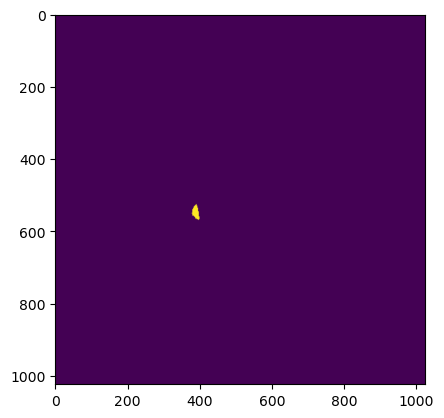

In [135]:
plt.imshow(mask_seq[:,:,1])

## Centroid of mask

In [148]:
def find_centroid(image):
    if not image.any():
        return np.nan, np.nan
    y_c, x_c = ndimage.center_of_mass(image)
    return int(y_c), int(x_c)

In [149]:
y_c, x_c = np.array([find_centroid(mask_seq[:, :, i])
                     for i in range(mask_seq.shape[2])]).T

## Vector to centroid from central point of image

In [150]:
def point_to_vec(ys, xs, origin_y, origin_x):
    return np.stack((ys - origin_y, xs - origin_x), axis=-1)

In [151]:
vecs = point_to_vec(y_c, x_c, mask_seq.shape[0] // 2, mask_seq.shape[1] // 2)

In [214]:
vecs[:100]

array([[  nan,   nan],
       [  36., -123.],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [ 107.,   79.],
       [ -71.,  111.],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [ 121.,   18.],
       [  nan,   nan],
       [  nan,   nan],
       [  99.,  -78.],
       [ -34.,  106.],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [ -33.,  104.],
       [ 114.,  -50.],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [ -20.,  107.],
       [  nan,   nan],
       [ 110.,   -1.],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [ -29.,  100.],
       [ -12.,  113.],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [  nan,   nan],
       [ -2

## Find angle of rotation between consecutive frames

In [153]:
def unit_vector(vec):
    return vec / np.linalg.norm(vec)

In [154]:
def vecs_to_angle(vec1, vec2):
    if np.isnan(vec1).any() | np.isnan(vec2).any():
        return np.nan
    
    u1 = unit_vector(vec1)
    u2 = unit_vector(vec2)

    return np.arccos(np.clip(np.dot(u1, u2), -1.0, 1.0))

In [155]:
angles = np.array([vecs_to_angle(vecs[k,:], vecs[k+1,:]) for k in range(vecs.shape[0]-1)])

In [156]:
angles_deg = angles * 180 / np.pi

In [157]:
np.where(angles_deg > 100)[0]

array([ 14,  19, 333, 334, 335, 354, 358, 467, 468, 482, 522, 531, 539])

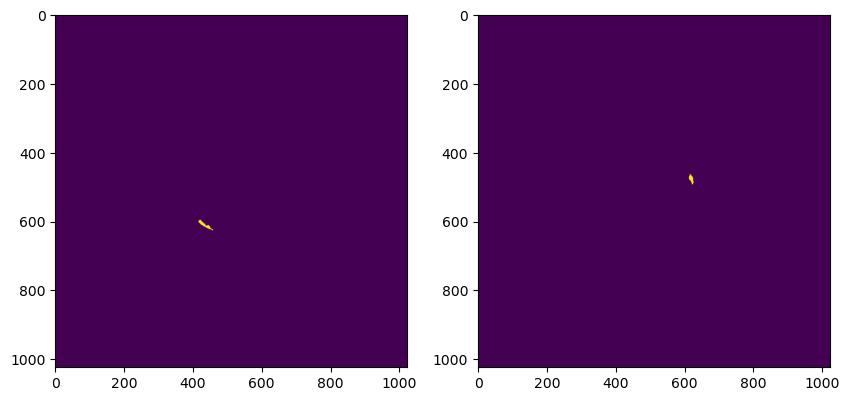

In [168]:
fig, axes = plt.subplots(1, 2, figsize=(10, 20))
axes[0].imshow(mask_seq[:,:,14])
axes[1].imshow(mask_seq[:,:,15])
fig.savefig('calcium_14_15')

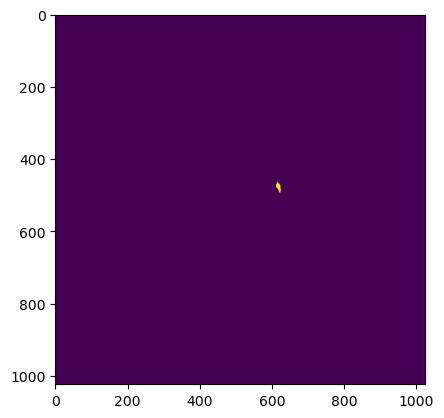

In [160]:
plt.imshow(mask_seq[:,:,15])
plt.savefig('calcium15')

## Plot angles in histogram

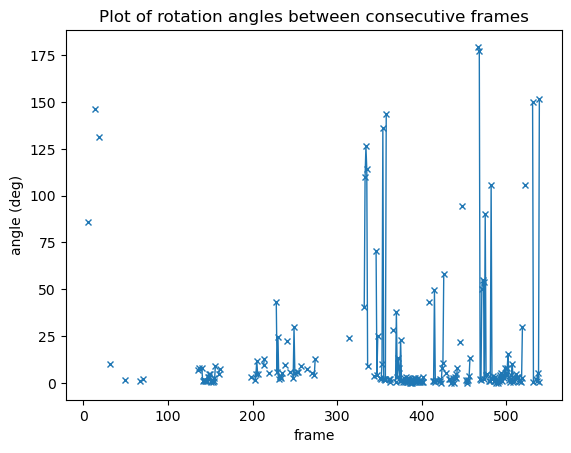

In [172]:
plt.plot(angles_deg, '-x', markersize=5, linewidth=1)
plt.title('Plot of rotation angles between consecutive frames')
plt.xlabel('frame')
plt.ylabel('angle (deg)')
plt.savefig('angles_plot')

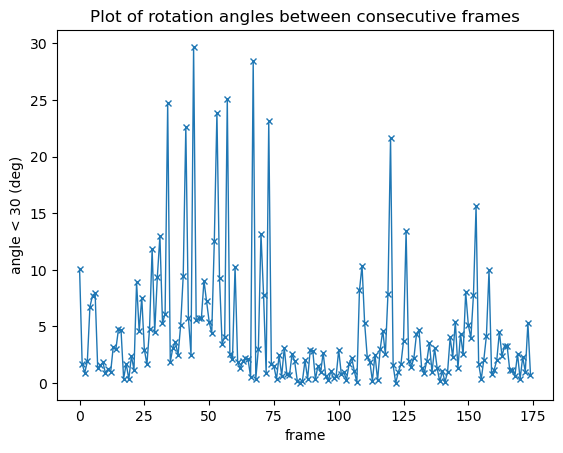

In [173]:
plt.plot(angles_deg[angles_deg < 30], '-x', markersize=5, linewidth=1)
plt.title('Plot of rotation angles between consecutive frames')
plt.xlabel('frame')
plt.ylabel('angle < 30 (deg)')
plt.savefig('angles_plot_clipped')

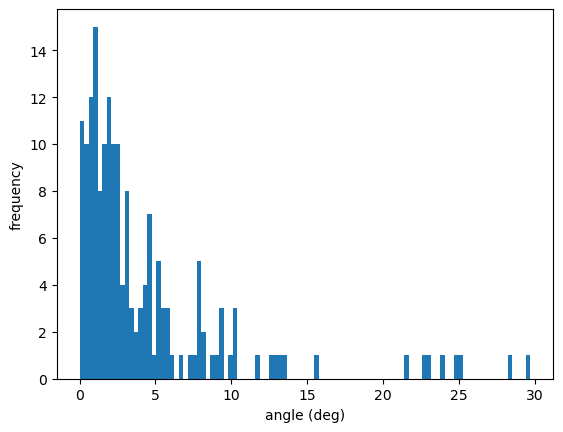

In [180]:
h = plt.hist(angles_deg[angles_deg < 30], bins=100)
plt.savefig('Histogram of consecutive frame angles up to 30 degrees')
plt.xlabel('angle (deg)')
plt.ylabel('frequency')
plt.savefig('angles_hist')

In [186]:
np.argmax(h_freq)

np.int64(3)

In [183]:
h_freq, h_bins = h[:2]

In [187]:
theta = h_bins[np.argmax(h_freq)]

In [188]:
theta

np.float64(0.8948206821158101)

## Apply rotation to all frames

In [273]:
theta_all = np.arange(mask_seq.shape[2]) * theta

In [261]:
def rotate_image_seq(image_seq, deg_seq):
    rotated_frames = [ndimage.rotate(image_seq[:,:,i], deg_seq[i], reshape=False)
                      for i in range(mask_seq.shape[2])]

    return np.stack(rotated_frames, axis=2)

In [251]:
rotated_seq = rotate_image_seq(mask_seq, theta_all)

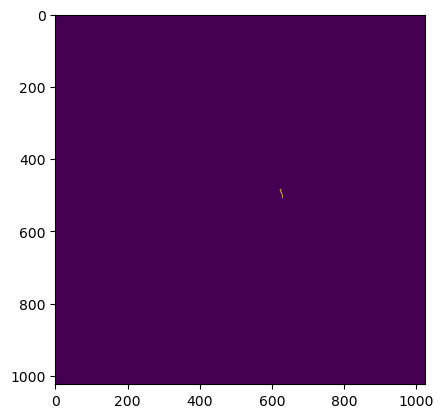

In [223]:
plt.imshow(mask_seq[:,:,70])

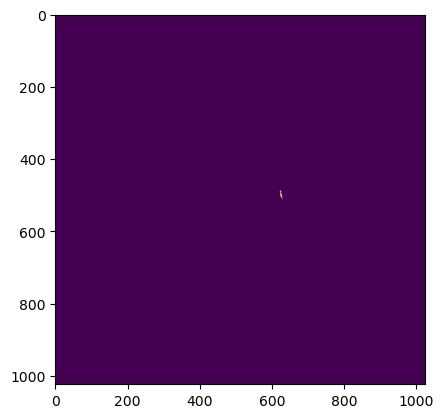

In [224]:
plt.imshow(mask_seq[:,:,71])

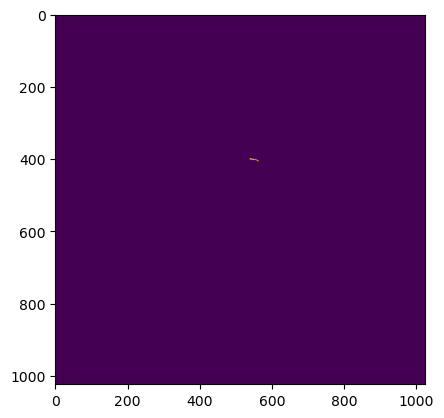

In [225]:
plt.imshow(rotated_seq[:,:,70])

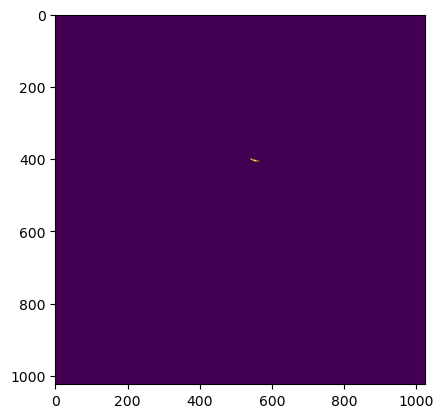

In [226]:
plt.imshow(rotated_seq[:,:,71])

In [244]:
lumen = np.load(os.path.join(DATA_DIR, 'centered_27cd6b8c7e8049edb874f9664c54f857_reorient-lumen.nii.gz.npy'))

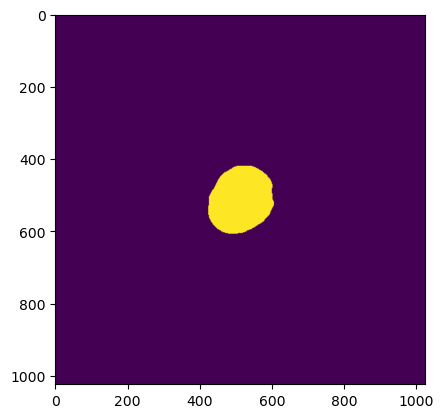

In [245]:
plt.imshow(lumen[:,:,0])

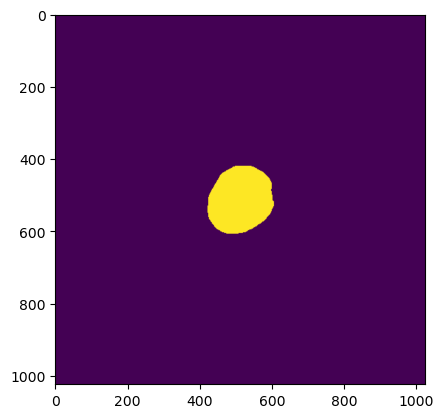

In [246]:
plt.imshow(lumen[:,:,5])

In [247]:
rotated_lumen = rotate_image_seq(lumen, theta_all)

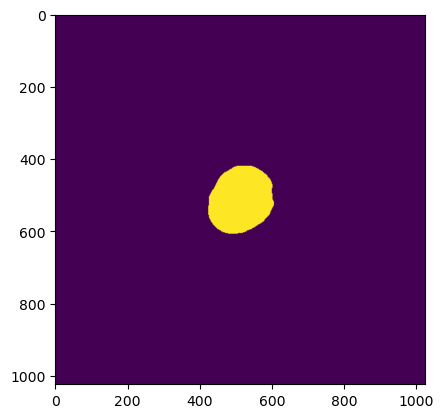

In [252]:
plt.imshow(rotated_lumen[:,:,0])

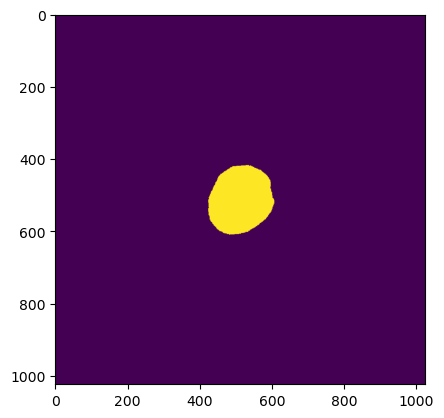

In [253]:
plt.imshow(rotated_lumen[:,:,5])

## Apply to all files

## Apply to image

In [274]:
img = np.load(os.path.join(DATA_DIR, 'centered_image.npy'))
rotated_img = rotate_image_seq(img, theta_all)

In [275]:
import matplotlib.animation as animation

In [276]:
from IPython.display import HTML

In [277]:
from matplotlib import rc
rc('animation', html='jshtml')

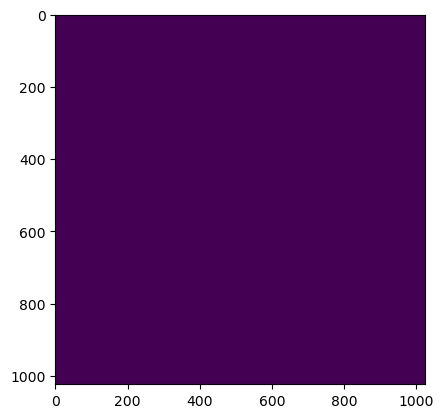

In [279]:
fig = plt.figure()

im = plt.imshow(rotated_seq[:,:,0], animated=True)

def update(i):
    im.set_array(rotated_seq[:,:,i])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=rotated_seq.shape[2], interval=40, blit=True)
HTML(ani.to_jshtml())

Animation size has reached 21057887 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


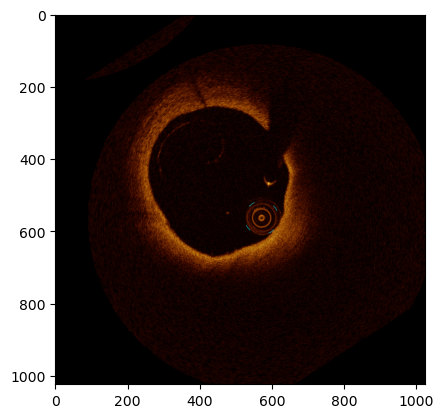

In [278]:
fig = plt.figure()

im = plt.imshow(rotated_img[:,:,0], animated=True)

def update(i):
    im.set_array(rotated_img[:,:,i])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=rotated_img.shape[2], interval=40, blit=True)
HTML(ani.to_jshtml())